# Object Detection with KerasCV


KerasCV offers a complete set of production grade APIs to solve object detection
problems.
These APIs include object-detection-specific
data augmentation techniques, Keras native COCO metrics, bounding box format
conversion utilities, visualization tools, pretrained object detection models,
and everything you need to train your own state of the art object detection
models!

Let's give KerasCV's object detection API a spin.

In [1]:
!pip install -q --upgrade keras-cv
!pip install -q --upgrade keras  # Upgrade to Keras 3.

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 613.1/613.1 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 9.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires keras<2.16,>=2.15.0, but you have keras 3.2.1 which is incompatible.


In [2]:
import os

os.environ["KERAS_BACKEND"] = "jax"  # @param ["tensorflow", "jax", "torch"]

from tensorflow import data as tf_data
import tensorflow_datasets as tfds
import keras
import keras_cv
import numpy as np
from keras_cv import bounding_box
import os
from keras_cv import visualization
import tqdm

## Object detection introduction

Обнаружение объектов — это процесс идентификации, классификации и локализации объектов на данном изображении. Обычно входными данными являются изображения, а метки — ограничивающие рамки с необязательными метками классов. Обнаружение объектов можно рассматривать как расширение классификации, однако вместо одной метки класса для изображения необходимо обнаружить и локализовать произвольное количество классов.

Например:

<img width="300" src="https://i.imgur.com/8xSEbQD.png">

Данные для изображения выше могут выглядеть примерно так:
```python
image = [height, width, 3]
bounding_boxes = {
  "classes": [0], # 0 is an arbitrary class ID representing "cat"
  "boxes": [[0.25, 0.4, .15, .1]]
   # bounding box is in "rel_xywh" format
   # so 0.25 represents the start of the bounding box 25% of
   # the way across the image.
   # The .15 represents that the width is 15% of the image width.
}
```

С момента создания You Only Look Once (также известного как YOLO) обнаружение объектов в основном решалось с помощью глубокого обучения. Большинство архитектур глубокого обучения делают это, умело формулируя проблему обнаружения объектов как комбинацию множества небольших задач классификации и множества проблем регрессии.

Более конкретно, это делается путем создания множества полей привязки различной формы и размера для входных изображений и присвоения каждому из них метки класса, а также , xи смещений . Модель обучена прогнозировать метки классов каждого блока, а также , , и смещения каждого блока, который прогнозируется как объект.ywidthheightxywidthheight

Визуализация некоторых примеров ящиков привязки :

<img width="400" src="https://i.imgur.com/cJIuiK9.jpg">

Обнаружение возражений — технически сложная задача, но, к счастью, мы предлагаем надежный подход к получению отличных результатов. Давай сделаем это!

### Выполняйте обнаружения с помощью предварительно обученной модели.

![](https://storage.googleapis.com/keras-nlp/getting_started_guide/prof_keras_beginner.png)

API самого высокого уровня в API обнаружения объектов KerasCV — это keras_cv.modelsAPI. Этот API включает в себя полностью предварительно обученные модели обнаружения объектов, такие как keras_cv.models.YOLOV8Detector.

Давайте начнем с создания YOLOV8Detector, предварительно обученного на pascalvoc наборе данных.

In [3]:
pretrained_model = keras_cv.models.YOLOV8Detector.from_preset(
    "yolo_v8_m_pascalvoc", bounding_box_format="xywh"
)

100%|██████████| 2.27k/2.27k [00:00<00:00, 1.21MB/s]
100%|██████████| 99.5M/99.5M [00:00<00:00, 123MB/s]


Посмотрим на архитектутру загруженной нейросети.

In [4]:
pretrained_model.summary()

Model: "yolov8_detector"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, None, None, 3)  │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ functional_1 (Functional) │ [(None, None, None,    │     11,872,464 │ input_layer_1[0][0]    │
│                           │ 192), (None, None,     │                │                        │
│                           │ None, 384), (None,     │                │                        │
│                           │ None, None, 576)]      │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ repeat (Repeat)           │ (None, None, None,     │              0 │ functional_1[0][2]     │
│                           │ 576)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ repeat_1 (Repeat)         │ (None, None, None,     │              0 │ repeat[0][0]           │
│                           │ 576)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_5             │ (None, None, None,     │              0 │ repeat_1[0][0],        │
│ (Concatenate)             │ 960)                   │                │ functional_1[0][1]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre_conv      │ (None, None, None,     │        368,640 │ concatenate_5[0][0]    │
│ (Conv2D)                  │ 384)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre_bn        │ (None, None, None,     │          1,536 │ pa_fpn_p4p5_pre_conv[… │
│ (BatchNormalization)      │ 384)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre           │ (None, None, None,     │              0 │ pa_fpn_p4p5_pre_bn[0]… │
│ (Activation)              │ 384)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ split_4 (Split)           │ [(None, None, None,    │              0 │ pa_fpn_p4p5_pre[0][0]  │
│                           │ 192), (None, None,     │                │                        │
│                           │ None, 192)]            │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre_0_1_pad   │ (None, None, None,     │              0 │ split_4[0][1]          │
│ (ZeroPadding2D)           │ 192)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre_0_1_conv  │ (None, None, None,     │        331,776 │ pa_fpn_p4p5_pre_0_1_p… │
│ (Conv2D)                  │ 192)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pa_fpn_p4p5_pre_0_1_bn    │ (None, None, None,     │            768 │ pa_fpn_p4p5_pre_0_1_c… │
│ (BatchNormalization)      │ 192)                   │                │                        │
├──────────────────────

 Total params: 25,901,004 (98.80 MB)

 Trainable params: 25,867,884 (98.68 MB)

 Non-trainable params: 33,120 (129.38 KB)

Определенно данная модель намного сложнее всех примеров арзитектуры, которые мы испольщзовали ранее. У нас как минимум 25.9 миллионов параметров около 100 узлов, слоев и масок в этой архитектуре. Не разрабатывая такой продукт самостоятельно понять всю специфику его работы будет крайне сложно.
Потому доверимся разработчикам и будем использовать их документацию.

Обратите внимание на bounding_box_formatаргумент?

Напомним, в разделе выше описан формат ограничивающих рамок:

```
bounding_boxes = {
  "classes": [num_boxes],
  "boxes": [num_boxes, 4]
}
```

Этот аргумент точно описывает , какой формат принимают значения в "boxes" поле словаря меток в вашем конвейере. Например, блок xywhформата с верхним левым углом по координатам (100, 100), шириной 55 и высотой 70 будет представлен следующим образом:
```
[100, 100, 55, 75]
```

или эквивалентно в xyxyформате:

```
[100, 100, 155, 175]
```

Хотя это может показаться простым, это важная часть API обнаружения объектов KerasCV! Каждый компонент, обрабатывающий ограничивающие рамки, требует bounding_box_formatаргумента. Подробнее о форматах ограничивающих рамок KerasCV можно прочитать в документации API .

Это сделано потому, что не существует единственного правильного формата ограничивающих рамок! Компоненты в разных конвейерах ожидают разных форматов, поэтому, требуя их указания, мы гарантируем, что наши компоненты остаются читаемыми, пригодными для повторного использования и понятными. Ошибки преобразования формата блока, возможно, являются наиболее распространенной проблемой в конвейерах обнаружения объектов. Требуя этот параметр, мы уменьшаем количество этих ошибок (особенно при объединении кода из многих источников).

Далее загрузим изображение:

In [11]:
foto = 'https://sun9-29.userapi.com/impf/KOES181XtF0pJ5Ws-pnWXPCLVTJhwnOK1mNGwQ/NgvTd3P15Vw.jpg?size=1920x768&quality=95&crop=0,124,1200,479&sign=b6a2bd7bbc552faabba0613a15bcd9c8&type=cover_group'

297015/297015 ━━━━━━━━━━━━━━━━━━━━ 0s 1us/step


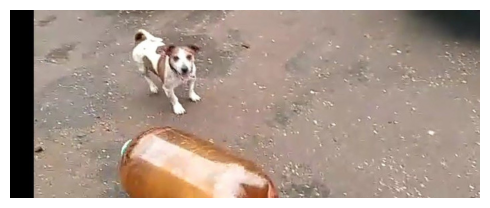

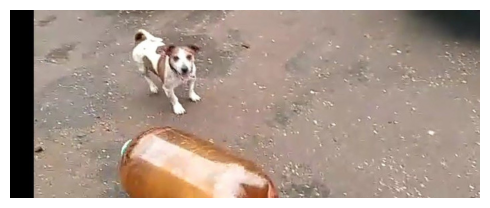

In [12]:
filepath = keras.utils.get_file(origin=foto)
image = keras.utils.load_img(filepath)
image = np.array(image)

visualization.plot_image_gallery(
    np.array([image]),
    value_range=(0, 255),
    rows=1,
    cols=1,
    scale=5,
)

In [16]:
image

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [ 33,  32,  37],
        [ 34,  33,  38],
        [ 33,  32,  37]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [ 29,  28,  33],
        [ 29,  28,  33],
        [ 29,  28,  33]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [ 25,  24,  29],
        [ 24,  23,  28],
        [ 24,  23,  28]],

       ...,

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [175, 157, 147],
        [174, 156, 146],
        [173, 155, 145]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [173, 155, 145],
        [173, 155, 145],
        [173, 155, 145]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [171, 153, 143],
        [172, 154, 144],
        [172, 154, 144]]

Чтобы использовать YOLOV8Detectorархитектуру с магистралью ResNet50, вам необходимо изменить размер изображения до размера, кратного 64. Это необходимо для обеспечения совместимости с количеством операций уменьшения масштаба, выполняемых слоями свертки в ResNet.

Если операция изменения размера искажает соотношение сторон входных данных, модель будет работать значительно хуже. Для предварительно обученной "yolo_v8_m_pascalvoc"предустановки, которую мы используем, финал MeanAveragePrecisionв pascalvoc/2012оценочном наборе снижается до значения 0.15 from 0.38при использовании простой операции изменения размера.

Кроме того, если вы обрезаете изображение, чтобы сохранить соотношение сторон, как при классификации, в вашей модели могут полностью пропасть некоторые ограничивающие рамки. Таким образом, при выполнении вывода по модели обнаружения объектов мы рекомендуем использовать отступы до желаемого размера, одновременно изменяя размер самого длинного размера, чтобы он соответствовал соотношению сторон.

KerasCV упрощает изменение размера; просто перейдите pad_to_aspect_ratio=Trueна keras_cv.layers.Resizingслой.

Это можно реализовать в одной строке кода:

In [17]:
inference_resizing = keras_cv.layers.Resizing(
    640, 640, pad_to_aspect_ratio=True, bounding_box_format="xywh"
)

Это можно использовать в качестве конвейера предварительной обработки вывода:

In [18]:
image_batch = inference_resizing([image])

keras_cv.visualization.plot_bounding_box_gallery()поддерживает class_mapping параметр, позволяющий указать, к какому классу было присвоено каждое поле. Давайте теперь соберем отображение классов.

In [19]:
class_ids = [
    "Aeroplane",
    "Bicycle",
    "Bird",
    "Boat",
    "Bottle",
    "Bus",
    "Car",
    "Cat",
    "Chair",
    "Cow",
    "Dining Table",
    "Dog",
    "Horse",
    "Motorbike",
    "Person",
    "Potted Plant",
    "Sheep",
    "Sofa",
    "Train",
    "Tvmonitor",
    "Total",
]
class_mapping = dict(zip(range(len(class_ids)), class_ids))

Как и любой другой, keras.Modelвы можете прогнозировать ограничивающие рамки с помощью model.predict()API.

1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


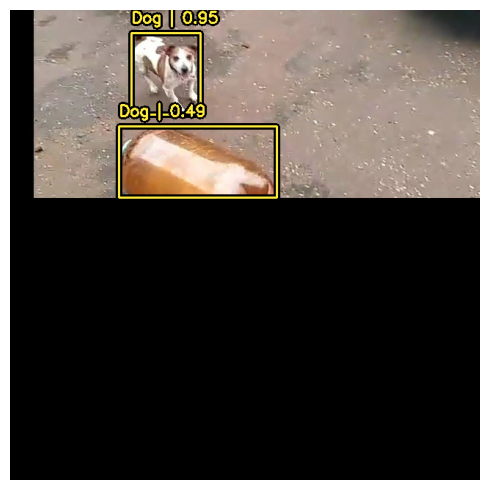

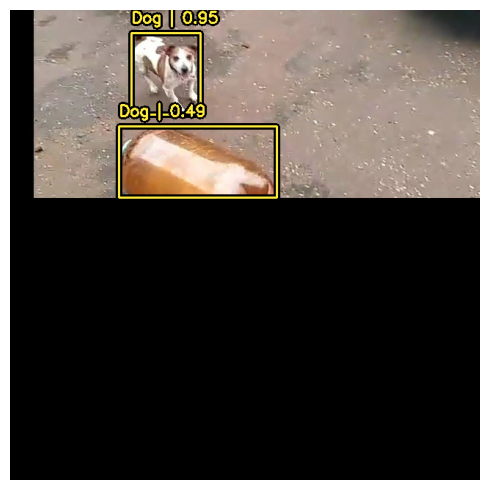

In [20]:
y_pred = pretrained_model.predict(image_batch)
# y_pred is a bounding box Tensor:
# {"classes": ..., boxes": ...}
visualization.plot_bounding_box_gallery(
    image_batch,
    value_range=(0, 255),
    rows=1,
    cols=1,
    y_pred=y_pred,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)

Чтобы поддержать этот простой и интуитивно понятный рабочий процесс вывода, KerasCV выполняет немаксимальное подавление внутри YOLOV8Detectorкласса. Немаксимальное подавление — это традиционный вычислительный алгоритм, который решает проблему обнаружения моделью нескольких блоков для одного и того же объекта.

Немаксимальное подавление — это алгоритм с широкими возможностями настройки, и в большинстве случаев вам потребуется настроить параметры немаксимального подавления вашей модели. Это можно сделать путем переопределения аргумента prediction_decoder.

Чтобы продемонстрировать эту концепцию, давайте временно отключим немаксимальное подавление на нашем YOLOV8Detector. Это можно сделать, записав в prediction_decoderатрибут.

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


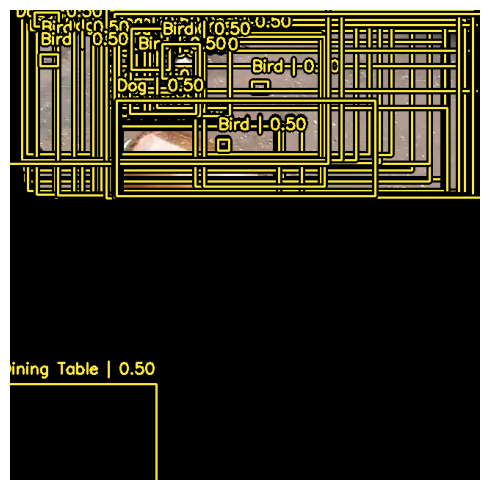

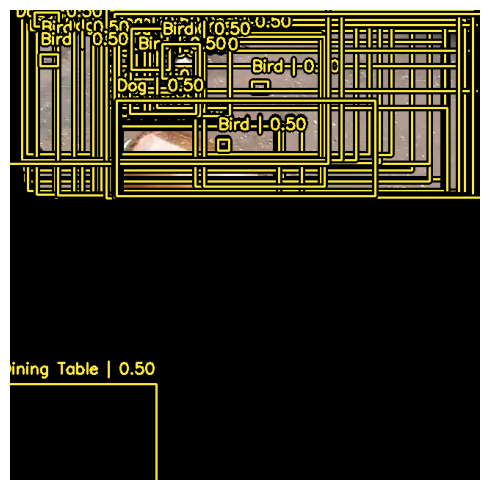

In [21]:
# Следующий уровень подавления, отличный от максимального, эквивалентен отключению операции
prediction_decoder = keras_cv.layers.NonMaxSuppression(
    bounding_box_format="xywh",
    from_logits=True,
    iou_threshold=1.0,
    confidence_threshold=0.0,
)
pretrained_model = keras_cv.models.YOLOV8Detector.from_preset(
    "yolo_v8_m_pascalvoc",
    bounding_box_format="xywh",
    prediction_decoder=prediction_decoder,
)

y_pred = pretrained_model.predict(image_batch)
visualization.plot_bounding_box_gallery(
    image_batch,
    value_range=(0, 255),
    rows=1,
    cols=1,
    y_pred=y_pred,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)


Мы видим что у нас множество ложных определений. Очевидно что данная нейросеть не очень адаптирована к подобному качеству изображений. Попробуем изменить тестовое изображение.

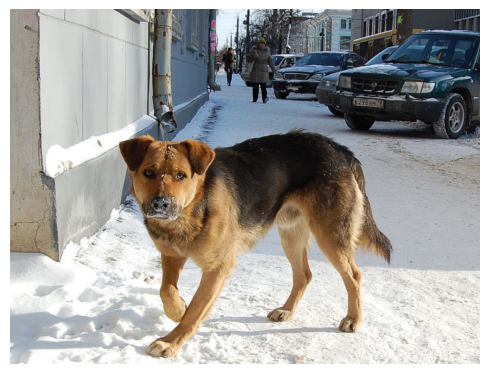

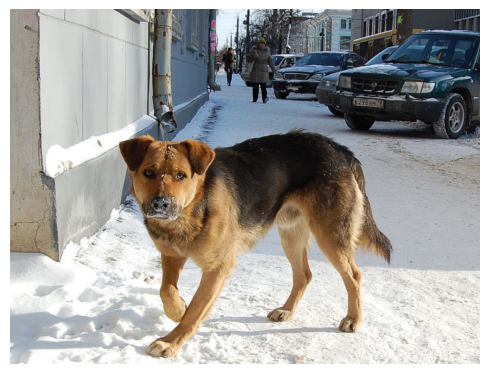

In [30]:
foto2 = 'https://i.postimg.cc/CLWX9XVV/224455.png'
filepath2 = keras.utils.get_file(origin=foto2)
image2 = keras.utils.load_img(filepath2)
image2 = np.array(image2)

visualization.plot_image_gallery(
    np.array([image2]),
    value_range=(0, 255),
    rows=1,
    cols=1,
    scale=5,
)

In [31]:
image_batch_2 = inference_resizing([image2])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


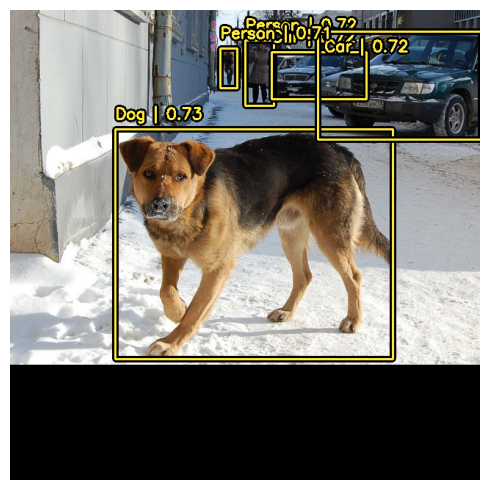

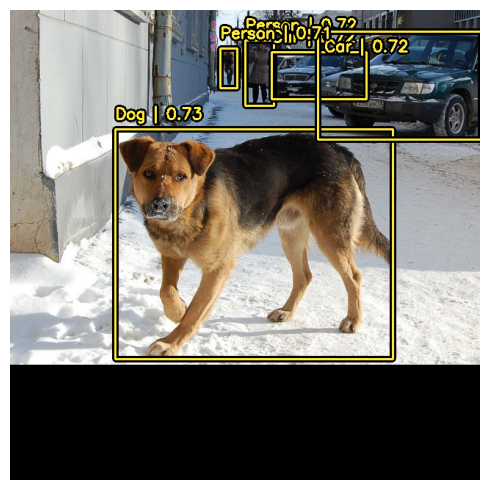

In [33]:
y_pred = pretrained_model.predict(image_batch_2)
# y_pred is a bounding box Tensor:
# {"classes": ..., boxes": ...}
visualization.plot_bounding_box_gallery(
    image_batch_2,
    value_range=(0, 255),
    rows=1,
    cols=1,
    y_pred=y_pred,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)

Далее давайте переконфигурируем keras_cv.layers.NonMaxSuppressionдля нашего варианта использования! В этом случае мы настроим iou_thresholdна 0.2и confidence_thresholdна 0.7.

Увеличение confidence_thresholdприведет к тому, что модель выведет только те поля, которые имеют более высокий показатель достоверности. iou_thresholdконтролирует порог пересечения по объединению (IoU), который должен иметь два поля, чтобы один был исключен. Дополнительную информацию об этих параметрах можно найти в документации TensorFlow API.

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


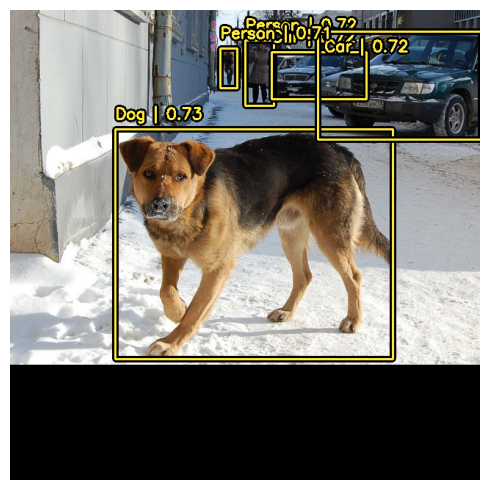

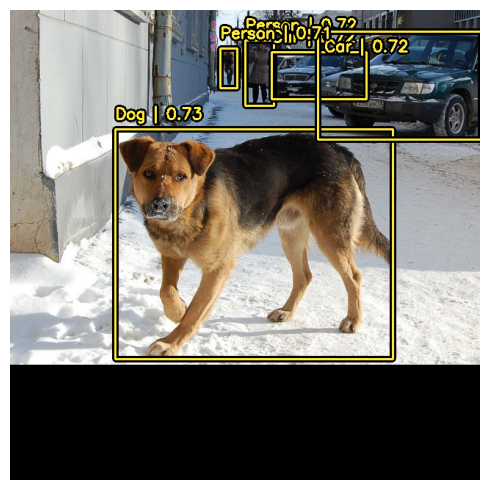

In [34]:
prediction_decoder = keras_cv.layers.NonMaxSuppression(
    bounding_box_format="xywh",
    from_logits=True,
    # Уменьшите требуемый порог, чтобы исключить возможность прогнозирования
    iou_threshold=0.2,
    # Настройка порога достоверности прогнозов для прохождения NMS
    confidence_threshold=0.7,
)
pretrained_model = keras_cv.models.YOLOV8Detector.from_preset(
    "yolo_v8_m_pascalvoc",
    bounding_box_format="xywh",
    prediction_decoder=prediction_decoder,
)

y_pred = pretrained_model.predict(image_batch_2)
visualization.plot_bounding_box_gallery(
    image_batch_2,
    value_range=(0, 255),
    rows=1,
    cols=1,
    y_pred=y_pred,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)

Это выглядит уже лучше.

## Обучение пользовательской модели обнаружения объектов

![](https://storage.googleapis.com/keras-nlp/getting_started_guide/prof_keras_advanced.png)

Независимо от того, являетесь ли вы любителем обнаружения объектов или опытным ветераном, сборка конвейера обнаружения объектов с нуля — это масштабная задача. К счастью, все API обнаружения объектов KerasCV построены как модульные компоненты. Нужен ли вам полный конвейер, просто модель обнаружения объектов или даже просто утилита преобразования для преобразования ваших блоков из xywhформата в xyxy, KerasCV поможет вам.

В этом руководстве мы соберем полный конвейер обучения для модели обнаружения объектов KerasCV. Это включает в себя загрузку данных, увеличение, оценку показателей и логические выводы!

Для начала давайте разберемся со всем нашим импортом и определим глобальные параметры конфигурации.

In [35]:
BATCH_SIZE = 4

## Загрузка данных

Для начала давайте обсудим загрузку данных и форматирование ограничивающей рамки. KerasCV имеет предопределенный формат ограничивающих рамок. Чтобы соответствовать этому, вам следует упаковать ограничивающие рамки в словарь, соответствующий приведенной ниже спецификации:

```
bounding_boxes = {
    # num_boxes may be a Ragged dimension
    'boxes': Tensor(shape=[batch, num_boxes, 4]),
    'classes': Tensor(shape=[batch, num_boxes])
}
```

bounding_boxes['boxes']содержит координаты вашей ограничивающей рамки в поддерживаемом KerasCV bounding_box_format. KerasCV требует bounding_box_formatаргумента во всех компонентах, обрабатывающих ограничивающие рамки. Это сделано для того, чтобы максимизировать ваши возможности по подключению и использованию отдельных компонентов в их конвейерах обнаружения объектов, а также для обеспечения самодокументируемости кода во всех конвейерах обнаружения объектов.

Чтобы соответствовать стилю API KerasCV, при написании собственного загрузчика данных рекомендуется также поддерживать аргумент bounding_box_format. Это дает понять тем, кто вызывает ваш загрузчик данных, в каком формате находятся ограничивающие рамки. В этом примере мы форматируем наши рамки в соответствии с xywhформатом.

Например:

```python
train_ds, ds_info = your_data_loader.load(
    split='train', bounding_box_format='xywh', batch_size=8
)
```

Это явно приводит к появлению ограничивающих рамок в формате xywh. Подробнее о форматах ограничивающих рамок KerasCV можно прочитать в документации API .

Наши данные загружаются в формат {"images": images, "bounding_boxes": bounding_boxes}. Этот формат поддерживается всеми компонентами предварительной обработки KerasCV.

Давайте загрузим некоторые данные и проверим, что они выглядят так, как мы ожидаем.

In [36]:

def visualize_dataset(inputs, value_range, rows, cols, bounding_box_format):
    inputs = next(iter(inputs.take(1)))
    images, bounding_boxes = inputs["images"], inputs["bounding_boxes"]
    visualization.plot_bounding_box_gallery(
        images,
        value_range=value_range,
        rows=rows,
        cols=cols,
        y_true=bounding_boxes,
        scale=5,
        font_scale=0.7,
        bounding_box_format=bounding_box_format,
        class_mapping=class_mapping,
    )


def unpackage_raw_tfds_inputs(inputs, bounding_box_format):
    image = inputs["image"]
    boxes = keras_cv.bounding_box.convert_format(
        inputs["objects"]["bbox"],
        images=image,
        source="rel_yxyx",
        target=bounding_box_format,
    )
    bounding_boxes = {
        "classes": inputs["objects"]["label"],
        "boxes": boxes,
    }
    return {"images": image, "bounding_boxes": bounding_boxes}


def load_pascal_voc(split, dataset, bounding_box_format):
    ds = tfds.load(dataset, split=split, with_info=False, shuffle_files=True)
    ds = ds.map(
        lambda x: unpackage_raw_tfds_inputs(x, bounding_box_format=bounding_box_format),
        num_parallel_calls=tf_data.AUTOTUNE,
    )
    return ds


train_ds = load_pascal_voc(
    split="train", dataset="voc/2007", bounding_box_format="xywh"
)
eval_ds = load_pascal_voc(split="test", dataset="voc/2007", bounding_box_format="xywh")

train_ds = train_ds.shuffle(BATCH_SIZE * 4)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating test examples...:   0%|          | 0/4952 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteLB7EDL/voc-test.tfrecord*...:   0%|          | 0/…

Generating train examples...:   0%|          | 0/2501 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteLB7EDL/voc-train.tfrecord*...:   0%|          | 0…

Generating validation examples...:   0%|          | 0/2510 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteLB7EDL/voc-validation.tfrecord*...:   0%|        …

Dataset voc downloaded and prepared to /root/tensorflow_datasets/voc/2007/4.0.0. Subsequent calls will reuse this data.


Далее давайте группируем наши данные.

В задачах обнаружения объектов KerasCV пользователям рекомендуется использовать неровные пакеты входных данных. Это связано с тем, что в PascalVOC изображения могут иметь разные размеры, а также с тем, что на одно изображение может приходиться разное количество ограничивающих рамок.

Чтобы создать неровный набор данных в tf.dataконвейере, вы можете использовать этот ragged_batch()метод.

In [37]:
train_ds = train_ds.ragged_batch(BATCH_SIZE, drop_remainder=True)
eval_ds = eval_ds.ragged_batch(BATCH_SIZE, drop_remainder=True)

Давайте убедимся, что наш набор данных соответствует формату, который ожидает KerasCV. Используя эту visualize_dataset()функцию, вы можете визуально убедиться, что ваши данные находятся в том формате, который ожидает KerasCV. Если ограничивающие рамки не видны или видны не в тех местах, это признак того, что ваши данные неправильно отформатированы.

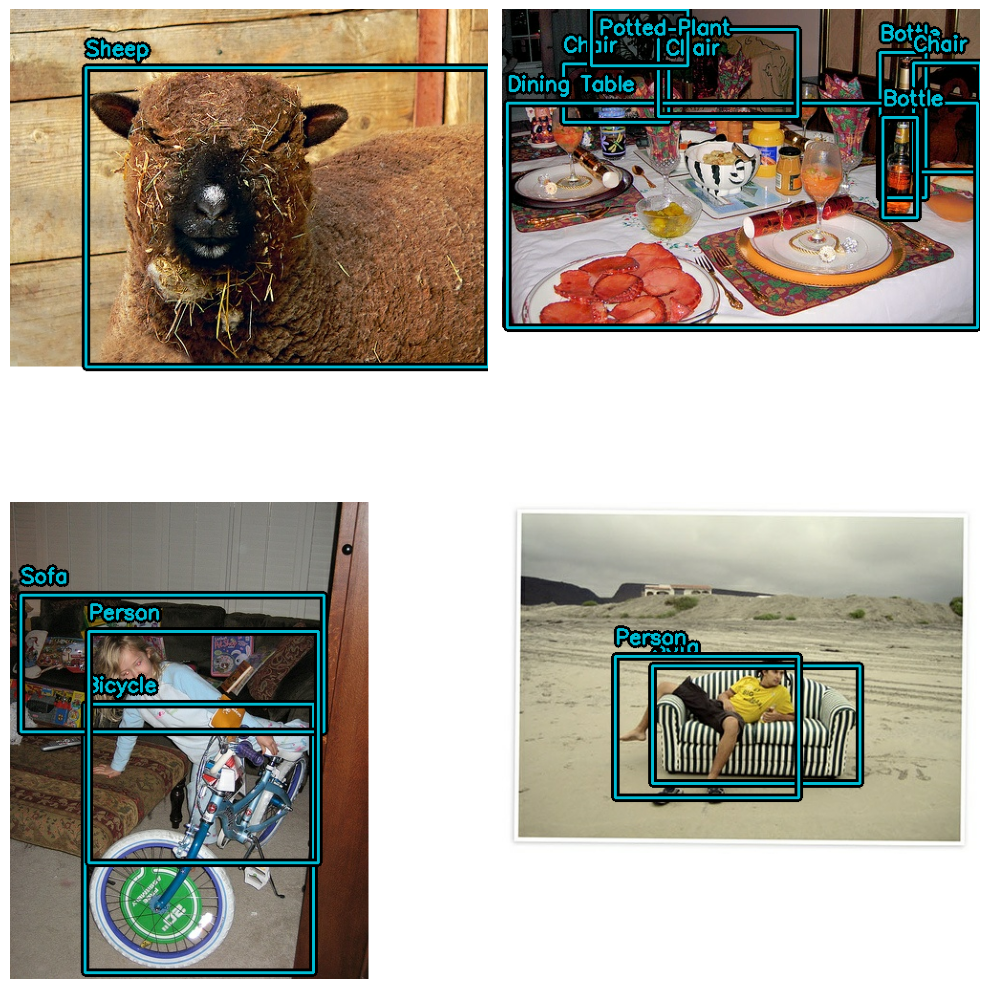

In [38]:
visualize_dataset(
    train_ds, bounding_box_format="xywh", value_range=(0, 255), rows=2, cols=2
)

И для оценочного набора:

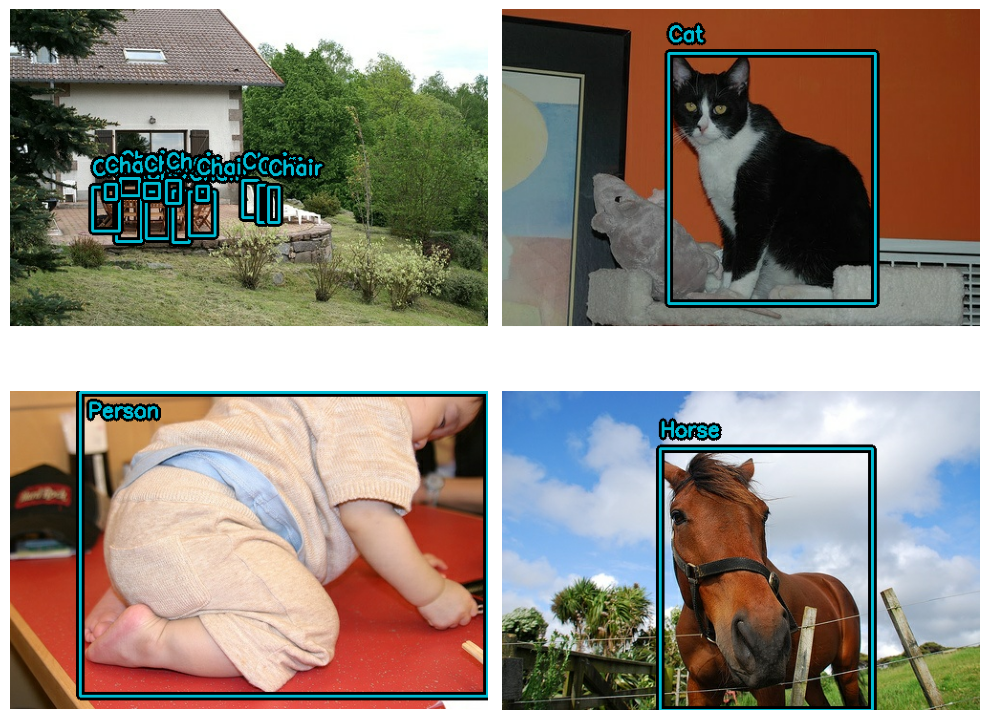

In [39]:
visualize_dataset(
    eval_ds,
    bounding_box_format="xywh",
    value_range=(0, 255),
    rows=2,
    cols=2,
    # Если вы не проводите эксперимент на локальном компьютере, вы также можете
    # сделать так, чтобы `visualize_dataset()` выводил график в файл, используя `path`:
    # path="eval.png"
)

Похоже, все структурировано так, как и ожидалось. Теперь мы можем перейти к построению нашего конвейера увеличения данных.

## Увеличение данных

Одной из наиболее сложных задач при построении конвейеров обнаружения объектов является увеличение данных. Методы увеличения изображения должны учитывать основные ограничивающие рамки и соответствующим образом обновлять их.

К счастью, KerasCV изначально поддерживает расширение ограничивающей рамки с помощью своей обширной библиотеки слоев расширения данных . Приведенный ниже код загружает набор данных Pascal VOC и выполняет оперативное увеличение данных с использованием ограничительной рамки внутри конвейера tf.data.

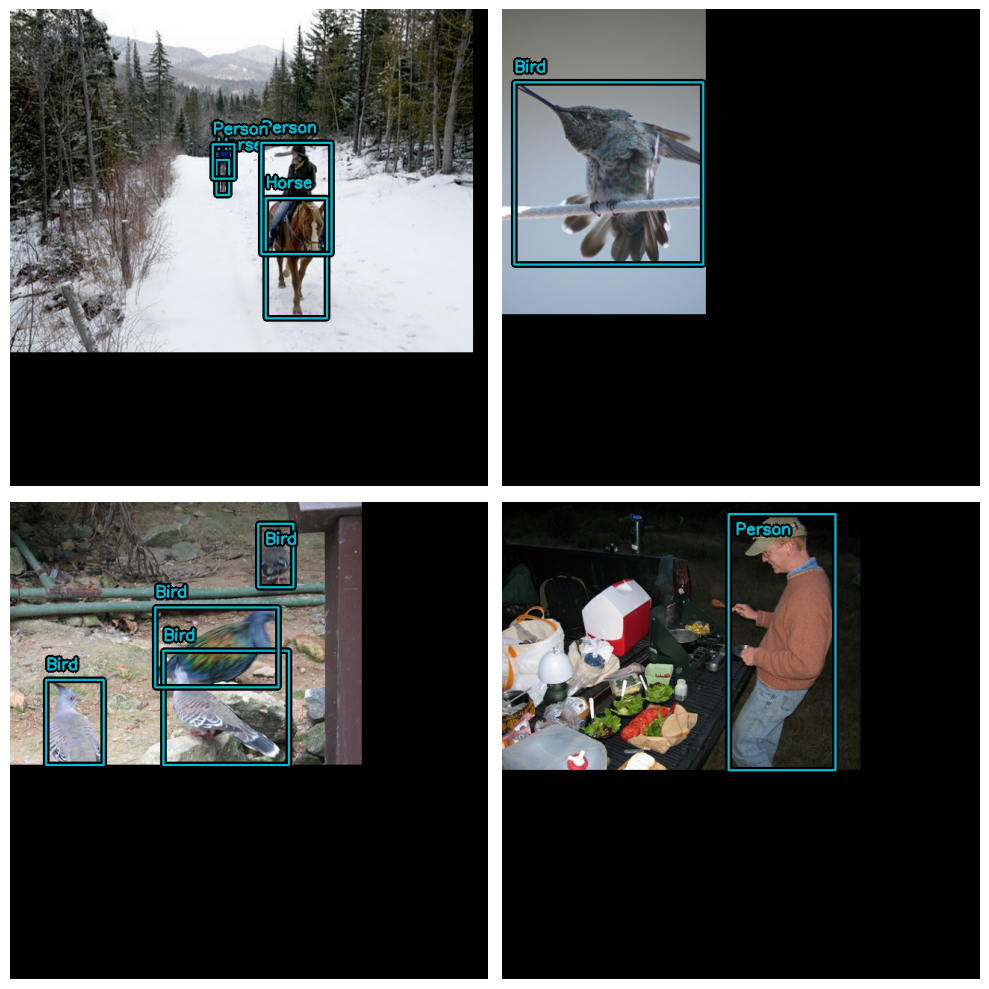

In [40]:
augmenters = [
    keras_cv.layers.RandomFlip(mode="horizontal", bounding_box_format="xywh"),
    keras_cv.layers.JitteredResize(
        target_size=(640, 640), scale_factor=(0.75, 1.3), bounding_box_format="xywh"
    ),
]


def create_augmenter_fn(augmenters):
    def augmenter_fn(inputs):
        for augmenter in augmenters:
            inputs = augmenter(inputs)
        return inputs

    return augmenter_fn


augmenter_fn = create_augmenter_fn(augmenters)

train_ds = train_ds.map(augmenter_fn, num_parallel_calls=tf_data.AUTOTUNE)
visualize_dataset(
    train_ds, bounding_box_format="xywh", value_range=(0, 255), rows=2, cols=2
)

Уже хорошо! Теперь у нас есть конвейер увеличения данных, удобный для использования ограничивающей рамки. Давайте отформатируем наш набор оценочных данных так, чтобы он соответствовал. Вместо использования JitteredResizeдавайте использовать детерминированный keras_cv.layers.Resizing() слой.

In [41]:
inference_resizing = keras_cv.layers.Resizing(
    640, 640, bounding_box_format="xywh", pad_to_aspect_ratio=True
)
eval_ds = eval_ds.map(inference_resizing, num_parallel_calls=tf_data.AUTOTUNE)

В связи с тем, что операция изменения размера различается для набора данных поезда, который используется JitteredResize()для изменения размера изображений, и набора данных вывода, который использует layers.Resizing(pad_to_aspect_ratio=True), рекомендуется визуализировать оба набора данных:

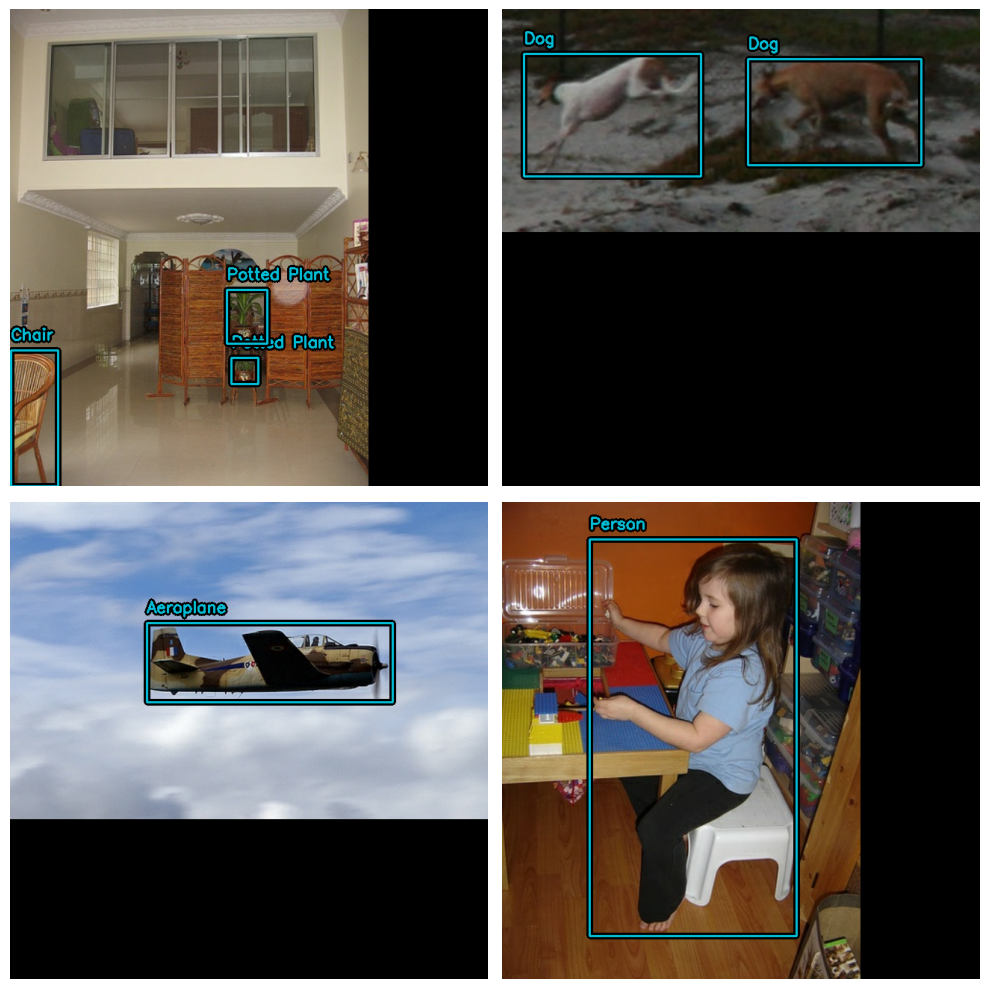

In [42]:
visualize_dataset(
    eval_ds, bounding_box_format="xywh", value_range=(0, 255), rows=2, cols=2
)

Наконец, давайте распакуем наши входные данные из словаря предварительной обработки и подготовимся передать их в нашу модель. Чтобы быть совместимым с TPU, тензоры ограничивающей рамки должны быть Denseвместо Ragged.

In [43]:

def dict_to_tuple(inputs):
    return inputs["images"], bounding_box.to_dense(
        inputs["bounding_boxes"], max_boxes=32
    )


train_ds = train_ds.map(dict_to_tuple, num_parallel_calls=tf_data.AUTOTUNE)
eval_ds = eval_ds.map(dict_to_tuple, num_parallel_calls=tf_data.AUTOTUNE)

train_ds = train_ds.prefetch(tf_data.AUTOTUNE)
eval_ds = eval_ds.prefetch(tf_data.AUTOTUNE)

## Оптимизатор
В этом руководстве мы используем стандартный оптимизатор SGD и полагаемся на обратный вызов [ keras.callbacks.ReduceLROnPlateau](/api/callbacks/reduce_lr_on_plateau#reducelronplateau-class) для снижения скорости обучения.

Вы всегда захотите включить global_clipnormпри обучении моделей обнаружения объектов. Это сделано для устранения проблем с взрывным градиентом, которые часто возникают при обучении моделей обнаружения объектов.

In [44]:
base_lr = 0.005
# including a global_clipnorm is extremely important in object detection tasks
optimizer = keras.optimizers.SGD(
    learning_rate=base_lr, momentum=0.9, global_clipnorm=10.0
)

Чтобы добиться наилучших результатов в вашем наборе данных, вам, вероятно, захочется вручную составить PiecewiseConstantDecayграфик скорости обучения. Хотя PiecewiseConstantDecayграфики, как правило, работают лучше, они не переносят задачи.

## Функции потерь
Возможно, вы не знакомы с "ciou"потерей. Хотя эта потеря не характерна для других моделей, она иногда используется в мире обнаружения объектов.

Короче говоря, «Полная IoU» — это вариант пересечения с потерей объединения и используется из-за его свойств конвергенции.

В KerasCV вы можете использовать эту потерю, просто передав строку "ciou"в compile(). Мы также используем стандартную двоичную кроссэнтропийную потерю для главы класса.

In [45]:
pretrained_model.compile(
    classification_loss="binary_crossentropy",
    box_loss="ciou",
)

## Метрическая оценка
Наиболее популярными метриками обнаружения объектов являются метрики COCO, которые публикуются вместе с набором данных MSCOCO. KerasCV предоставляет простой в использовании набор метрик COCO под этим keras_cv.callbacks.PyCOCOCallback символом. Обратите внимание, что мы используем обратный вызов Keras вместо метрики Keras для вычисления метрик COCO. Это связано с тем, что вычисление метрик COCO требует одновременного хранения в памяти всех прогнозов модели для всего набора оценочных данных, что нецелесообразно делать во время обучения.

In [46]:
coco_metrics_callback = keras_cv.callbacks.PyCOCOCallback(
    eval_ds.take(20), bounding_box_format="xywh"
)

Наш конвейер данных готов! Теперь мы можем перейти к созданию и обучению модели.

## Создание модели
Далее давайте воспользуемся API KerasCV для создания необученной модели YOLOV8Detector. В этом уроке мы используем предварительно обученную магистраль ResNet50 из набора данных imagenet.

KerasCV позволяет легко построить соединение YOLOV8Detectorс любой из магистралей KerasCV. Просто используйте один из пресетов для желаемой архитектуры!

Например:

In [47]:
model = keras_cv.models.YOLOV8Detector.from_preset(
    "resnet50_imagenet",
    # Для получения дополнительной информации о поддерживаемых форматах ограничивающих рамок посетите сайт
    # https://keras.io/api/keras_cv/bounding_box/
    bounding_box_format="xywh",
    num_classes=20,
)

100%|██████████| 777/777 [00:00<00:00, 1.37MB/s]
100%|██████████| 90.3M/90.3M [00:01<00:00, 81.9MB/s]


Это все, что нужно для создания KerasCV YOLOv8. YOLOv8 принимает кортежи плотных тензоров изображений и словари ограничительных рамок для fit()и train_on_batch()

Это соответствует тому, что мы построили в нашем входном конвейере выше.

## Обучение нашей модели
Осталось только обучить нашу модель. Модели обнаружения объектов KerasCV следуют стандартному рабочему процессу Keras, используя compile()и fit().

Скомпилируем нашу модель:

In [48]:
model.compile(
    classification_loss="binary_crossentropy",
    box_loss="ciou",
    optimizer=optimizer,
)

Если вы хотите полностью обучить модель, удалите .take(20)из всех ссылок на наборы данных (ниже и при инициализации обратного вызова метрик).

In [49]:
model.fit(
    train_ds.take(20),
    # Обучение в течение 10-35 ~ эпох, чтобы набрать хорошие результаты.
    epochs=1,
    callbacks=[coco_metrics_callback],
)

20/20 ━━━━━━━━━━━━━━━━━━━━ 21s 771ms/step
creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.62s).
Accumulating evaluation results...
DONE (t=0.27s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.001
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.002
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.012
 Average Recall     (AR) @[ IoU=0.50:0.95

На самом деле довольно сложно оценить эффективность обучения такой модели - на 20 эпохах мы получили loss: 8972.0967. Выглядит не очень перспективно. Однако это очень тяжелая модель и требует много вычислительных мощностей.
Мы продоодим изучать эту тему и по возможности дообучим эту модель уже на 35 эпохах.

## Выводы и графические результаты
KerasCV упрощает процесс обнаружения объектов. model.predict(images) возвращает тензор ограничивающих рамок. По умолчанию YOLOV8Detector.predict() выполнит для вас немаксимальную операцию подавления.

В этом разделе мы будем использовать keras_cvпредоставленный пресет:

In [50]:
model = keras_cv.models.YOLOV8Detector.from_preset(
    "yolo_v8_m_pascalvoc", bounding_box_format="xywh"
)

Далее для удобства строим набор данных с более крупными пакетами:

In [51]:
visualization_ds = eval_ds.unbatch()
visualization_ds = visualization_ds.ragged_batch(16)
visualization_ds = visualization_ds.shuffle(8)

Давайте создадим простую функцию для построения наших выводов:

In [52]:
def visualize_detections(model, dataset, bounding_box_format):
    images, y_true = next(iter(dataset.take(1)))
    y_pred = model.predict(images)
    visualization.plot_bounding_box_gallery(
        images,
        value_range=(0, 255),
        bounding_box_format=bounding_box_format,
        y_true=y_true,
        y_pred=y_pred,
        scale=4,
        rows=2,
        cols=2,
        show=True,
        font_scale=0.7,
        class_mapping=class_mapping,
    )

Возможно, вам придется настроить операцию NonMaxSuppression для достижения визуально привлекательных результатов.

1/1 ━━━━━━━━━━━━━━━━━━━━ 26s 26s/step


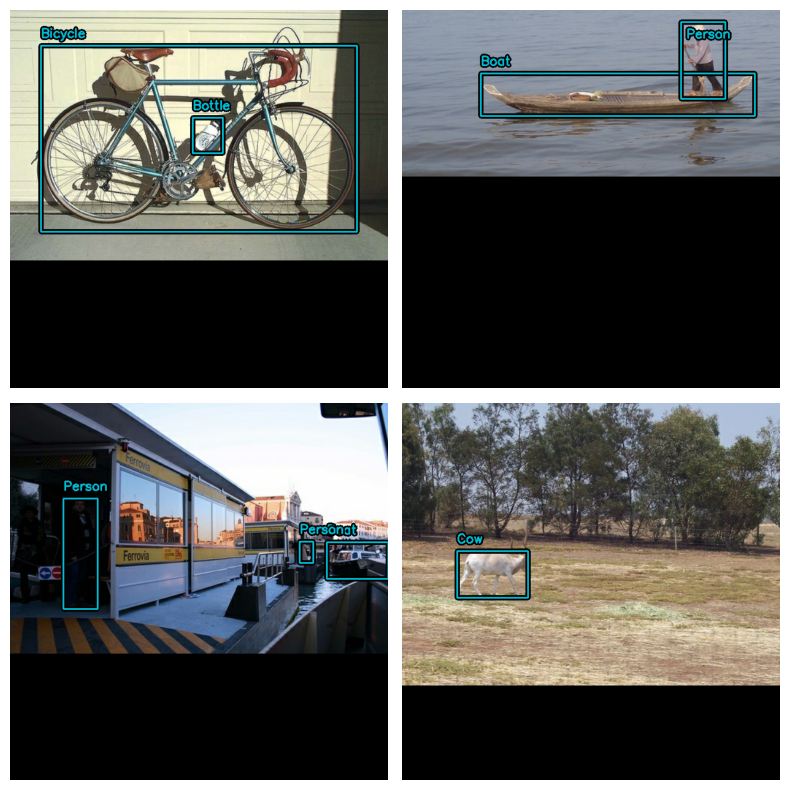

In [53]:
model.prediction_decoder = keras_cv.layers.NonMaxSuppression(
    bounding_box_format="xywh",
    from_logits=True,
    iou_threshold=0.5,
    confidence_threshold=0.75,
)

visualize_detections(model, dataset=visualization_ds, bounding_box_format="xywh")

Потрясающе и результативно ! И последний полезный шаблон, о котором следует помнить, — это визуализация обнаружений в процессе keras.callbacks.Callbackмониторинга обучения:

In [54]:
class VisualizeDetections(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        visualize_detections(
            self.model, bounding_box_format="xywh", dataset=visualization_ds
        )

## Выводы и следующие шаги
KerasCV позволяет легко создавать современные конвейеры обнаружения объектов. В этом руководстве мы начали с написания загрузчика данных, используя спецификацию ограничивающей рамки KerasCV. После этого мы собрали конвейер увеличения данных промышленного уровня, используя слои предварительной обработки KerasCV, в <50 строках кода.

Компоненты обнаружения объектов KerasCV могут использоваться независимо, но также имеют глубокую интеграцию друг с другом. KerasCV упрощает создание ограничивающих рамок производственного уровня, обучение моделей, визуализацию и оценку показателей.

Некоторые дополнительные упражнения для читателя:

добавить дополнительные методы увеличения для улучшения производительности модели
настроить гиперпараметры и увеличение данных, используемые для получения высококачественных результатов
обучить модель обнаружения объектов на собственном наборе данных
Последний забавный фрагмент кода, демонстрирующий возможности API KerasCV!

By using this model checkpoint, you acknowledge that its usage is subject to the terms of the CreativeML Open RAIL++-M license at https://github.com/Stability-AI/stablediffusion/blob/main/LICENSE-MODEL
1356917/1356917 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
1361968152/1361968152 ━━━━━━━━━━━━━━━━━━━━ 26s 0us/step
3464605600/3464605600 ━━━━━━━━━━━━━━━━━━━━ 77s 0us/step
50/50 ━━━━━━━━━━━━━━━━━━━━ 258s 2s/step
198180272/198180272 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


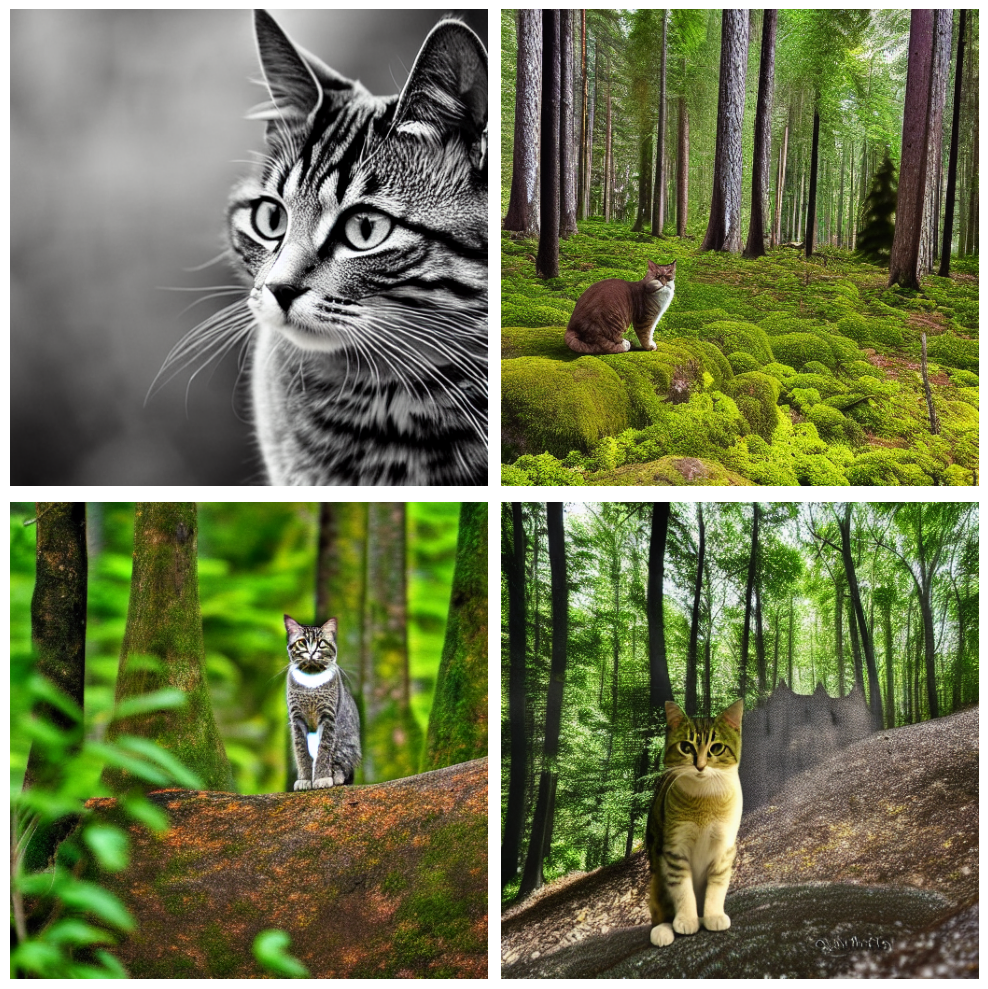

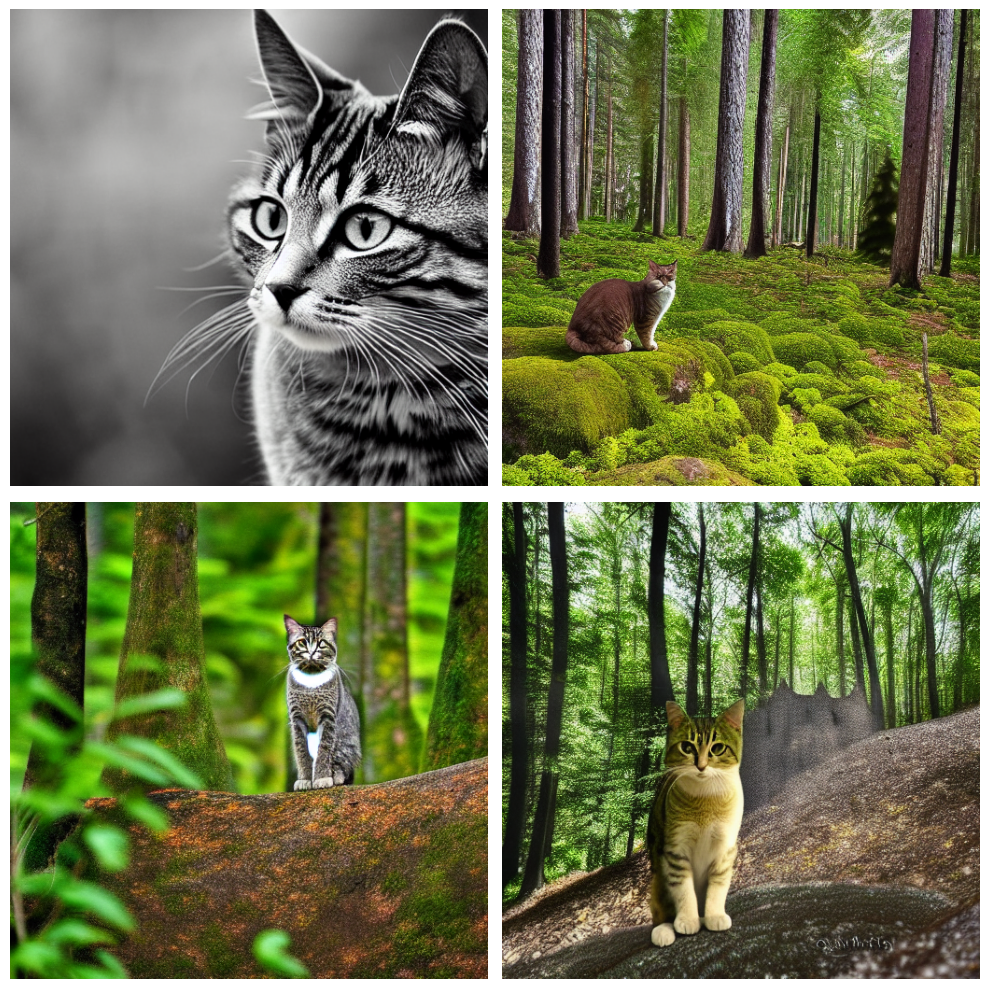

In [55]:
stable_diffusion = keras_cv.models.StableDiffusionV2(512, 512)
images = stable_diffusion.text_to_image(
    prompt="A zoomed out photograph of a cool looking cat.  The cat stands in a beautiful forest",
    negative_prompt="unrealistic, bad looking, malformed",
    batch_size=4,
    seed=1231,
)
encoded_predictions = model(images)
y_pred = model.decode_predictions(encoded_predictions, images)
visualization.plot_bounding_box_gallery(
    images,
    value_range=(0, 255),
    y_pred=y_pred,
    rows=2,
    cols=2,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)

By using this model checkpoint, you acknowledge that its usage is subject to the terms of the CreativeML Open RAIL++-M license at https://github.com/Stability-AI/stablediffusion/blob/main/LICENSE-MODEL
50/50 ━━━━━━━━━━━━━━━━━━━━ 144s 2s/step


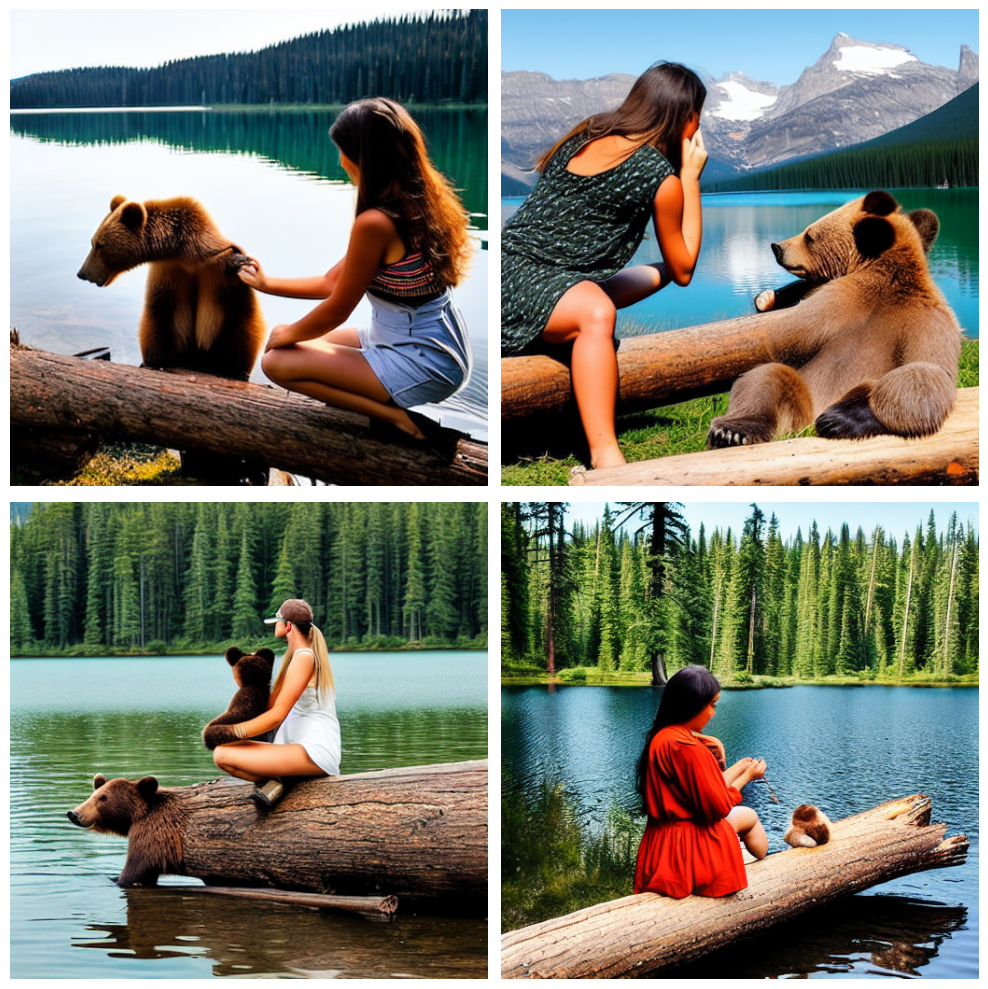

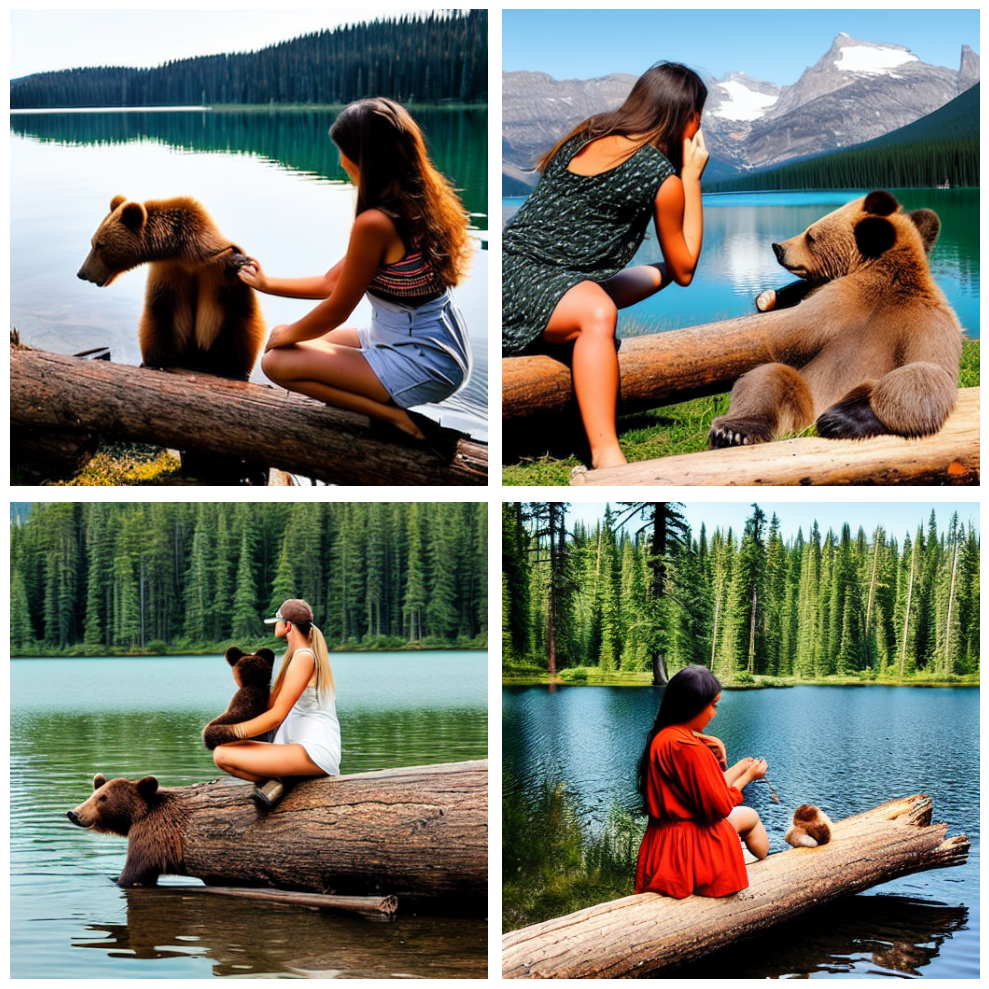

In [56]:
stable_diffusion = keras_cv.models.StableDiffusionV2(512, 512)
images = stable_diffusion.text_to_image(
    prompt="a girl feeds a big bear. The bear is sitting on a log. A girl on the background of a lake",
    negative_prompt="unrealistic, bad looking, malformed",
    batch_size=4,
    seed=1231,
)
encoded_predictions = model(images)
y_pred = model.decode_predictions(encoded_predictions, images)
visualization.plot_bounding_box_gallery(
    images,
    value_range=(0, 255),
    y_pred=y_pred,
    rows=2,
    cols=2,
    scale=5,
    font_scale=0.7,
    bounding_box_format="xywh",
    class_mapping=class_mapping,
)

Генерация картинки на достаточно высоком уровне. Однако затраты времени составили более 6 минут, что явно уступает возможностям открытых генеративных нейросетей вроде midjorney которые даже через API выдают результат куда быстрее.
Однако генеративная нейросеть у себя дома все равно лучше чем у кого то в гостях.

Узучим какие еще существуют архитектуры отличные от использованных выше.

EfficientNet можно рассматривать как группу моделей сверточных нейронных сетей. Но с учетом некоторых тонкостей он на самом деле более эффективен, чем большинство его предшественников.

Группа моделей EfficientNet состоит из 8 моделей от B0 до B7, каждый последующий номер модели относится к вариантам с большим количеством параметров и большей точностью.

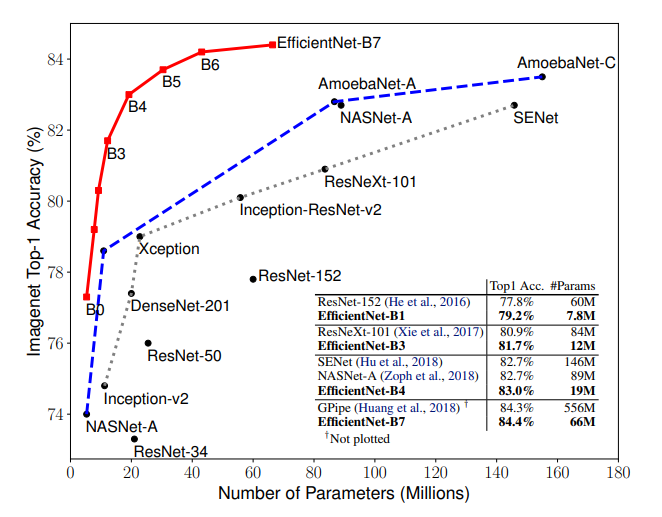

Тогда возникает вопрос: Что эффективно? Мы видим, что успех моделей в наборе данных ImageNet увеличился, поскольку они стали более сложными с 2012 года. Однако большинство из них неэффективны с точки зрения нагрузки на обработку. В последние годы были приняты более эффективные подходы к меньшим моделям. Настолько, что при уменьшении масштаба модели масштабирование выполняется по глубине, ширине и разрешению - сосредоточение внимания на всех трех в сочетании позволило добиться более эффективных результатов. Да, эффективно.

Учитывая это, архитектура модели EfficientNet должна масштабироваться в три этапа.

❄️Как работает EfficientNet
В трех основных шагах можно понять, почему это более эффективно.



Глубинная свертка + Точечная свертка: делит исходную свертку на два этапа, чтобы значительно снизить стоимость вычислений с минимальной потерей точности.
Обратное разрешение: исходные блоки ResNet состоят из слоя, который сжимает каналы, а затем слоя, который расширяет каналы. Таким образом, он связывает пропущенные соединения с богатыми слоями каналов. Однако в MBConv блоки состоят из уровня, который сначала расширяет каналы, а затем сжимает их, так что слои с меньшим количеством каналов пропускаются.
Линейное узкое место: использует линейную активацию на последнем уровне в каждом блоке, чтобы предотвратить потерю информации из ReLU.
Основным строительным блоком для EfficientNet является MBConv, перевернутое узкое место, первоначально известное как MobileNetV2. Использование ярлыков между узкими местами путем подключения гораздо меньшего количества каналов (по сравнению с расширяющимися слоями) было объединено с глубокой разделяемой сверткой, которая сократила расчет почти на k² по сравнению с традиционными слоями. Где k обозначает размер ядра, он определяет высоту и ширину двумерного окна свертки.

from keras.layers import Conv2D, DepthwiseConv2D, Adddef inverted_residual_block(x, expand=64, squeeze=16):
    block = Conv2D(expand, (1,1), activation=’relu’)(x)
    block = DepthwiseConv2D((3,3), activation=’relu’)(block)
    block = Conv2D(squeeze, (1,1), activation=’relu’)(block)
    return Add()([block, x])


Более крупные сети с большей шириной, глубиной или разрешением, как правило, обеспечивают более высокую точность. Однако, как только прирост точности достигает 80%, он быстро насыщается. Это указывает на ограничение одномерного масштабирования. Техника индивидуального масштабирования называется составным масштабированием.

Если вы хотите увеличить FLOPS в 2 раза с EfficientNetB0 до EfficientNetB7 (чтобы гарантировать, что EfficientNetB1 имеет 2x FLOPS по сравнению с EfficientNetB0), необходимо использовать следующий подход:

глубина: d = α φ

ширина: w = β φ

разрешение: r = γ φ s.t. α · β 2 · γ 2 ≈ 2

α ≥ 1, β ≥ 1, γ ≥ 1

❄️Создание модели EfficientNet


Шаг 1️⃣ : Построение базовой модели называется EfficientNet- B0. MBConv используется с перевернутыми узкими местами MobileNet Res.



Шаг 2️⃣ : ϕ = 1 и поиск по сетке α, β и масштабирование от B0 до B1.

Шаг 3️⃣ : установка α, β, γ. Таким образом, для масштабирования от B2 до B7 ϕ выбирается между 2 ~ 7. Ниже вы можете увидеть карты активации классов для моделей с различными методами масштабирования.



Похоже, что метод составного масштабирования более эффективно фокусируется на деталях в областях, связанных с объектами.

❄️Влияние трансфертного обучения на EfficientNet
На мгновение давайте сделаем небольшой шаг назад от мельчайших деталей EfficientNet. Представьте, что птица может передать вам то, что она выучила.

Другими словами, я с рождения и от предков научился узнавать стакан. Есть простые особенности (край, угол, форма, структура материала и т. д.). Оказывается, что-то происходит, когда машины учатся - они передают то, что знают и чему учатся, на другие машины, пропуская весь процесс обучения.


Предварительно обученные модели - это модели, которые ранее были обучены и сохранены в большом наборе данных, таком как ImageNet. Таким образом, изученные функции полезны для решения многих новых задач компьютерного зрения. Однако эти новые проблемы могут включать классы, которые полностью отличаются от исходной задачи, и их не следует игнорировать.

Например, изображение может обучать сеть в ImageNet (где классы - это в основном животные и предметы повседневного обихода), а затем повторно использовать эту обученную сеть для таких разрозненных задач, как идентификация моделей автомобилей. Однако в этом случае вам потребуются различные подходы, специфичные для вашей проблемы, чтобы классифицировать данные, которых нет в наборе данных ImageNet.

Мы используем предварительно обученные модели только в приложениях, где мы хотим только тестировать и прогнозировать. Для EfficientNet трансферное обучение экономит время и вычислительную мощность, как и любая другая модель. При этом он обеспечивает более высокую точность, чем многие известные модели. Это связано с умным масштабированием по глубине, ширине и разрешению. Давайте посмотрим на точность и соотношение параметров для разных наборов данных:



🌈 T Реализация EfficientNet Transfer Learning доступна через Google Colab - записную книжку можно найти в репозитории GitHub ниже:



Такие модели, как EfficientNet, особенно полезны для использования глубокого обучения на периферии, поскольку они сокращают затраты на вычисления, использование батареи, а также скорость обучения и вывода. Такая эффективность модели в конечном итоге позволяет использовать глубокое обучение на мобильных и других периферийных устройствах. На мой взгляд, этих эффективных решений можно достичь с помощью простых и умных математических преобразований.

На лекции и семинаре мы изучили одноэтапные (YOLO,SSD) и двухэтапные (RCNN,Fast RCNN,Faster RCNN,FPN) алгоритмы обнаружения объектов.
Осталось познакомиться с трансформаторным подходом(Relation Net, DETR).

### Трансформаторные подходы

Отношения между объектами потенциально могут повысить точность обнаружения в задачах обнаружения объектов. Однако как одноэтапные, так и двухэтапные алгоритмы обнаружения объектов не эффективно использовали механизмы внимания для фиксации взаимосвязей объектов до появления моделей Transformer. Одной из потенциальных причин является проблема моделирования отношений между объектами, поскольку положения, масштабы, категории и количество объектов различаются на разных изображениях. Большинство современных методов, основанных на CNN, имеют простую, регулярную сетевую структуру, которая с трудом справляется с этими сложными явлениями. Чтобы решить эту проблему, Relation Net и DETR представили Transformers для моделирования отношений между различными объектами и включения механизмов внимания в обнаружение объектов.

### Сеть отношений(Relation Net)

Несмотря на использование Transformers, Relation Net по-прежнему является усовершенствованием Faster RCNN. Faster RCNN генерирует серию предложений региона с помощью сети RPN, которые затем передаются в нейронную сеть для прогнозирования положения и классов объектов. Вместо того, чтобы напрямую вводить предложения регионов в окончательную сеть прогнозирования, Relation Net сначала пропускает эти предложения через преобразователь. Механизм внимания используется для объединения информации о взаимосвязях между предложениями различных регионов, улучшая характеристики. Выходные данные преобразователя затем передаются в окончательную сеть прогнозирования для прогнозирования положения и классов объектов. Кроме того, модуль преобразователя заменяет модуль немаксимального подавления (NMS), обеспечивая сквозное обучение.$$

### DEtection TRansformer

DETR (DEtection TRansformer) представляет собой значительную работу, в которой Трансформеры используются для задач обнаружения объектов.

DETR сначала использует CNN для извлечения признаков из изображения и добавляет кодирование позиции — метод, обычно используемый в обработке естественного языка (NLP), — для генерации сериализованного набора данных.

На этапе кодирования сериализованные данные передаются в кодировщик, который извлекает признаки с помощью механизмов внимания.

На этапе декодера вводятся N случайно инициализированных объектных запросов, причем каждый запрос обращается к разным позициям на изображении. После механизма внимания декодер выводит N предсказаний ограничивающего прямоугольника и предсказаний классов.

Наконец, венгерский алгоритм сопоставления используется для сопоставления предсказанных блоков с основными блоками истины.

DETR полностью отказывается от использования полей привязки, предложений регионов и модулей NMS. Вместо этого он рассматривает обнаружение объектов как задачу прогнозирования прямого набора, устраняя необходимость в этапах постобработки, таких как настройка привязки и немаксимальное подавление.

Изучить тему лучше можно по ссылке
https://habr.com/ru/articles/736950/
https://arxiv.org/abs/2005.12872